In [14]:
import sys
import os

# Get the parent directory of the current notebook
module_path = os.path.abspath(os.path.join('..'))

# Add the model directory to the Python path
if module_path not in sys.path:
    sys.path.append(module_path)

In [15]:
from RBFNN import RBFNN
from ELM import ELM
from sklearn.linear_model import LinearRegression
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn import metrics
from ModelWrapper import ModelWrapper

In [16]:
import mlflow
from mlflow.models import infer_signature

In [17]:
pd.set_option('display.max_colwidth', None)

# Przygotowanie danych

In [18]:
data_path = "../../data/4_tanks/data/"

In [19]:
# dane bez zakłóceń
df_train = pd.read_csv(data_path+"result_ol_without_noise_uczące_v3.csv", sep=';', index_col=0)
df_val = pd.read_csv(data_path+"result_ol_without_noise_walidacyjne_v3.csv", sep=';', index_col=0)
df_test = pd.read_csv(data_path+"result_ol_without_noise_testowe_v3.csv", sep=';', index_col=0)
dataset_name = "bez zakłóceń"

In [20]:
# # dane z zakłóceniami
# df_train = pd.read_csv(data_path+"result_ol_with_noise_uczące_v3.csv", sep=';', index_col=0)
# df_val = pd.read_csv(data_path+"result_ol_with_noise_walidacyjne_v3.csv", sep=';', index_col=0)
# df_test = pd.read_csv(data_path+"result_ol_with_noise_testowe_v3.csv", sep=';', index_col=0)
# dataset_name = "z zakłóceniami"

In [21]:
df_train.head()

,q_A [cm^3/s],q_B [cm^3/s],q_d1 [cm^3/s],q_d2 [cm^3/s],q_d3 [cm^3/s],q_d4 [cm^3/s],x1 [cm],x2 [cm],x3 [cm],x4 [cm]
0,452.78,555.56,0.0,0.0,0.0,0.0,65.000000,66.000000,65.000000,66.000000
1,452.78,555.56,0.0,0.0,-0.0,0.0,64.984326,65.937304,65.038198,65.992639
2,452.78,555.56,0.0,-0.0,0.0,-0.0,64.971213,65.878615,65.074774,65.985573
3,452.78,555.56,0.0,0.0,-0.0,-0.0,64.960438,65.823672,65.109799,65.978790
4,452.78,555.56,0.0,-0.0,0.0,-0.0,64.951795,65.772231,65.143339,65.972278


In [22]:
def transform_column_name(df):
    df.columns = [col[0] for col in df.columns.str.split()]
    return df

In [23]:
df_train = transform_column_name(df_train)
df_val = transform_column_name(df_val)
df_test = transform_column_name(df_test)

In [24]:
qa_max = round(3260000/3600, 2)
qa_min=0
qb_max = round(4000000/3600)
qb_min=0
x_max = 136
x_min = 20

In [25]:
def min_max_scale(s, min_value, max_value):
    return (s-min_value)/(max_value - min_value)

In [26]:
def min_max_scale_df(df):
    df['q_A'] = min_max_scale(df['q_A'], qa_min, qa_max)
    df['q_B'] = min_max_scale(df['q_B'], qb_min, qb_max)
    df['x1'] = min_max_scale(df['x1'], x_min, x_max)
    df['x2'] = min_max_scale(df['x2'], x_min, x_max)
    df['x3'] = min_max_scale(df['x3'], x_min, x_max)
    df['x4'] = min_max_scale(df['x4'], x_min, x_max)
    return df

In [27]:
df_train = min_max_scale_df(df_train)
df_val = min_max_scale_df(df_val)
df_test = min_max_scale_df(df_test)

In [28]:
def add_delay(df, col, steps=1):    
    df[col+f'(k-{steps})'] = df[col].shift(steps)
    return df

In [29]:
cols_delay = ['q_A', 'q_B', 'x1', 'x2', 'x3', 'x4']
for col in cols_delay:
    df_train = add_delay(df_train, col, 1)
    df_val = add_delay(df_val, col, 1)
    df_test = add_delay(df_test, col, 1)
    df_train = add_delay(df_train, col, 2)
    df_val = add_delay(df_val, col, 2)
    df_test = add_delay(df_test, col, 2)
    df_train = add_delay(df_train, col, 3)
    df_val = add_delay(df_val, col, 3)
    df_test = add_delay(df_test, col, 3)
    df_train = add_delay(df_train, col, 4)
    df_val = add_delay(df_val, col, 4)
    df_test = add_delay(df_test, col, 4)

In [30]:
df_train.dropna(inplace=True)
df_val.dropna(inplace=True)
df_test.dropna(inplace=True)

In [31]:
print(f"Wymiar danych uczących: {df_train.shape}")
print(f"Wymiar danych walidacyjnych: {df_val.shape}")
print(f"Wymiar danych testowych: {df_test.shape}")

Wymiar danych uczących: (2996, 34)
Wymiar danych walidacyjnych: (996, 34)
Wymiar danych testowych: (996, 34)


# Modelowanie

In [32]:
mlflow.set_tracking_uri("http://localhost:5000")

In [33]:
model_class_list = ["LR", "ELM", "RBF"]
model_class_str = model_class_list[1]
pred_mode = "both"

In [34]:
y_names = ['x1', 'x2', 'x3', 'x4']

In [35]:
model_type_dict = {'statespace': 'w przestrzeni stanu', 'io': 'wejście-wyjście'}

In [36]:
def calc_RMSE(df_train, df_val, df_test, y_name, y_pred_name):
    RMSE_train = round(metrics.root_mean_squared_error(df_train[y_name], df_train[y_pred_name]), 4)
    RMSE_val = round(metrics.root_mean_squared_error(df_val[y_name], df_val[y_pred_name]), 4)
    RMSE_test = round(metrics.root_mean_squared_error(df_test[y_name], df_test[y_pred_name]), 4)

    return RMSE_train, RMSE_val, RMSE_test

In [57]:
def predict_recursion(df, model, features, y_name, order_dyn):
    y_pred_list = np.empty(len(df))
    start_idx = 0
    if order_dyn == 1:
        y_pred_list[0] = df[y_name].iloc[0]
        start_idx = 1
    elif order_dyn==2:
        y_pred_list[0] = df[y_name].iloc[0]
        y_pred_list[1] = df[y_name].iloc[1]
        start_idx = 2
    elif order_dyn==3:
        y_pred_list[0] = df[y_name].iloc[0]
        y_pred_list[1] = df[y_name].iloc[1]
        y_pred_list[2] = df[y_name].iloc[2]
        start_idx = 3
    elif order_dyn==4:
        y_pred_list[0] = df[y_name].iloc[0]
        y_pred_list[1] = df[y_name].iloc[1]
        y_pred_list[2] = df[y_name].iloc[2]
        y_pred_list[3] = df[y_name].iloc[3]
        start_idx = 4
    for i in range(start_idx, len(df)):
        features_val = df[features].iloc[i].copy()
        # print(f'features_val:\n{features_val}')
        if order_dyn == 1:
            features_val[f'{y_name}(k-1)'] = y_pred_list[i-1]
        if order_dyn == 2:
            features_val[f'{y_name}(k-1)'] = y_pred_list[i-1]
            features_val[f'{y_name}(k-2)'] = y_pred_list[i-2]
        if order_dyn == 3:
            features_val[f'{y_name}(k-1)'] = y_pred_list[i-1]
            features_val[f'{y_name}(k-2)'] = y_pred_list[i-2]
            features_val[f'{y_name}(k-3)'] = y_pred_list[i-3]
        if order_dyn == 4:
            features_val[f'{y_name}(k-1)'] = y_pred_list[i-1]
            features_val[f'{y_name}(k-2)'] = y_pred_list[i-2]
            features_val[f'{y_name}(k-3)'] = y_pred_list[i-3]
            features_val[f'{y_name}(k-4)'] = y_pred_list[i-4]
        # print(f'features_val:\n{features_val}')
        y_pred_list[i] = model.predict(pd.DataFrame(features_val).T).values
        # print(f'y_pred: {y_pred_list[i]}')
    return y_pred_list

In [74]:
def train_predict_lin_model(df_train, df_val, df_test, model_class_str, y_names, features_list, model_type, order_dyn, pred_mode='both', **kwargs):

    for y_name, features in zip(y_names, features_list):

        mlflow.set_experiment(f"four_tanks_{y_name}")

        n_features = len(features)
        params = {"model_class": model_class_str, "model_type": model_type_dict[model_type], "order_dyn": order_dyn, "y_name": y_name+'(k)', "features": features} | kwargs
        model = ELM(n_features, num_hidden_neurons)
        model.fit(df_train[features], df_train[[y_name]])

        pred_mode_tuple = ("both", "not_recursion", "recursion")
        # TODO: sprawdzić jak zadziała w przypadku błędnej wartości
        metrics_not_rec = {}
        metrics_rec = {}
        if pred_mode not in pred_mode_tuple:
            raise ValueError(f"Bad value for recursion_mode agument. Possible values: {recursion_mode_tuple}")
        if pred_mode in ("both", "not_recursion"):
            df_train[f'{y_name}_{model_type}_{order_dyn}_pred'] = model.predict(df_train[features])
            df_val[f'{y_name}_{model_type}_{order_dyn}_pred'] = model.predict(df_val[features])
            df_test[f'{y_name}_{model_type}_{order_dyn}_pred'] = model.predict(df_test[features])
            RMSE_train, RMSE_val, RMSE_test = calc_RMSE(df_train, df_val, df_test, y_name, f'{y_name}_{model_type}_{order_dyn}_pred')
            metrics_not_rec = {"RMSE_train": RMSE_train, "RMSE_val": RMSE_val, "RMSE_test": RMSE_test}
        if pred_mode in ("both", "recursion"):
            df_train[f'{y_name}_{model_type}_{order_dyn}_recursion_pred'] = predict_recursion(df_train, model, features, y_name, order_dyn)
            df_val[f'{y_name}_{model_type}_{order_dyn}_recursion_pred'] = predict_recursion(df_val, model, features, y_name, order_dyn)
            df_test[f'{y_name}_{model_type}_{order_dyn}_recursion_pred'] = predict_recursion(df_test, model, features, y_name, order_dyn)
            RMSE_train, RMSE_val, RMSE_test = calc_RMSE(df_train, df_val, df_test, y_name, f'{y_name}_{model_type}_{order_dyn}_recursion_pred')
            metrics_rec = {"RMSE_train_recursion": RMSE_train, "RMSE_val_recursion": RMSE_val, "RMSE_test_recursion": RMSE_test}

        metrics = metrics_not_rec | metrics_rec
        
        with mlflow.start_run():
            mlflow.log_params(params)
            mlflow.log_metrics(metrics)

            # Infer the model signature
            signature = infer_signature(df_train[features], df_train[f'{y_name}_{model_type}_{order_dyn}_pred'])
            # Log the model
            if model_class_str == 'LR':
                model_info = mlflow.sklearn.log_model(
                sk_model=model,
                artifact_path=model_class_str,
                signature=signature,
                input_example=df_train[features],
                registered_model_name=f"{model_class_str}_{model_type}_{order_dyn}_{y_name}",
            )
            else:
                model_info = mlflow.pyfunc.log_model(
                    python_model=ModelWrapper(model),
                    artifact_path=model_class_str,
                    signature=signature,
                    input_example=df_train[features],
                    registered_model_name=f"{model_class_str}_{model_type}_{order_dyn}_{y_name}",
                )

    return df_train, df_val, df_test

In [111]:
num_hidden_neurons = 20

In [112]:
pred_mode = "both"

In [113]:
features_list = [['q_A(k-1)', 'q_B(k-1)', 'x2(k-1)', 'x3(k-1)', 'x4(k-1)', 'x1(k-1)'],
                 ['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'x3(k-1)', 'x4(k-1)', 'x2(k-1)'],
                 ['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'x2(k-1)', 'x4(k-1)', 'x3(k-1)'],
                 ['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'x2(k-1)', 'x3(k-1)', 'x4(k-1)']]
model_type = 'statespace'
order_dyn = 1
df_train, df_val, df_test = train_predict_lin_model(df_train, df_val, df_test, model_class_str, y_names, features_list, model_type, order_dyn, pred_mode, num_hidden_neurons = num_hidden_neurons)

C:\Users\zgore\AppData\Local\Temp\ipykernel_34020\3818305289.py:40: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred_list[i] = model.predict(pd.DataFrame(features_val).T).values
C:\Users\zgore\AppData\Local\Temp\ipykernel_34020\3818305289.py:40: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred_list[i] = model.predict(pd.DataFrame(features_val).T).values
C:\Users\zgore\AppData\Local\Temp\ipykernel_34020\3818305289.py:40: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 

In [104]:
features_list = [['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x2(k-1)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x3(k-1)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x4(k-1)']]
model_type = 'io'
order_dyn = 1
df_train, df_val, df_test = train_predict_lin_model(df_train, df_val, df_test, model_class_str, y_names, features_list, model_type, order_dyn, pred_mode, num_hidden_neurons = num_hidden_neurons)

C:\Users\zgore\AppData\Local\Temp\ipykernel_34020\3818305289.py:40: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred_list[i] = model.predict(pd.DataFrame(features_val).T).values
C:\Users\zgore\AppData\Local\Temp\ipykernel_34020\3818305289.py:40: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred_list[i] = model.predict(pd.DataFrame(features_val).T).values
C:\Users\zgore\AppData\Local\Temp\ipykernel_34020\3818305289.py:40: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 

In [102]:
features_list = [['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x1(k-2)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x2(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x2(k-2)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x3(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x3(k-2)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x4(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x4(k-2)']]
model_type = 'io'
order_dyn = 2
df_train, df_val, df_test = train_predict_lin_model(df_train, df_val, df_test, model_class_str, y_names, features_list, model_type, order_dyn, pred_mode, num_hidden_neurons = num_hidden_neurons)

C:\Users\zgore\AppData\Local\Temp\ipykernel_34020\3818305289.py:40: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred_list[i] = model.predict(pd.DataFrame(features_val).T).values
C:\Users\zgore\AppData\Local\Temp\ipykernel_34020\3818305289.py:40: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred_list[i] = model.predict(pd.DataFrame(features_val).T).values
C:\Users\zgore\AppData\Local\Temp\ipykernel_34020\3818305289.py:40: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 

In [82]:
features_list = [['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x1(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x1(k-3)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x2(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x2(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x2(k-3)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x3(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x3(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x3(k-3)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x4(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x4(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x4(k-3)']]
model_type = 'io'
order_dyn = 3
df_train, df_val, df_test = train_predict_lin_model(df_train, df_val, df_test, model_class_str, y_names, features_list, model_type, order_dyn, pred_mode, num_hidden_neurons = num_hidden_neurons)

C:\Users\zgore\AppData\Local\Temp\ipykernel_34020\3818305289.py:40: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred_list[i] = model.predict(pd.DataFrame(features_val).T).values
C:\Users\zgore\AppData\Local\Temp\ipykernel_34020\3818305289.py:40: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred_list[i] = model.predict(pd.DataFrame(features_val).T).values
C:\Users\zgore\AppData\Local\Temp\ipykernel_34020\3818305289.py:40: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 

In [262]:
# features_list = [['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x1(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x1(k-3)', 'q_A(k-4)', 'q_B(k-4)', 'x1(k-4)'],
#  ['q_A(k-1)', 'q_B(k-1)', 'x2(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x2(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x2(k-3)', 'q_A(k-4)', 'q_B(k-4)', 'x2(k-4)'],
#  ['q_A(k-1)', 'q_B(k-1)', 'x3(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x3(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x3(k-3)', 'q_A(k-4)', 'q_B(k-4)', 'x3(k-4)'],
#  ['q_A(k-1)', 'q_B(k-1)', 'x4(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x4(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x4(k-3)', 'q_A(k-4)', 'q_B(k-4)', 'x4(k-4)']]
# model_type = 'io'
# order_dyn = 4
# df_train, df_val, df_test = train_predict_lin_model(df_train, df_val, df_test, model_class_str, y_names, features_list, model_type, order_dyn, pred_mode, num_hidden_neurons = num_hidden_neurons)

C:\Users\zgore\AppData\Local\Temp\ipykernel_8416\2579815219.py:40: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred_list[i] = model.predict(pd.DataFrame(features_val).T)
C:\Users\zgore\AppData\Local\Temp\ipykernel_8416\2579815219.py:40: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred_list[i] = model.predict(pd.DataFrame(features_val).T)
C:\Users\zgore\AppData\Local\Temp\ipykernel_8416\2579815219.py:40: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred_l

In [90]:
def plot_model_result(df, y_name, y_pred_list):
    plt.grid()
    plt.plot(df[y_name], label=f'dane rzeczywiste')
    colors = ['tab:orange', 'tab:green', 'tab:purple', 'tab:red', 'tab:cyan', 'tab:gray']
    color_i=0
    line_styles = ['--', '-.', (0, (5, 5)), (0, (3, 5, 1, 5)), ':']
    for i, y_name_pred in enumerate(y_pred_list):
        plt.plot(y_pred_list, label=f'wyjście modelu {i+1}', linestyle=line_styles[i % len(line_styles)], c=colors[i%len(colors)])
    plt.xlabel('k')
    plt.ylabel(f'$x_{y_name[1]} [cm]$')
    plt.title(f"Poziom cieczy w {y_name[1]}. zbiorniku")
    plt.legend()

In [106]:
def plot_model_result_all_tanks(df, dataset_name, data_name, pred_mode, y_pred_dict):
    num_plots = 4
    # if pred_mode=='z rekurencją':
    #     num_plots=5
    fig=plt.figure(figsize=(8,11.5))
    plt.subplot(num_plots, 1, 1)
    plot_model_result(df, 'x1', y_pred_dict['x1'])
    plt.subplot(num_plots, 1, 2)
    plot_model_result(df, 'x2', y_pred_dict['x2'])
    plt.subplot(num_plots, 1, 3)
    plot_model_result(df, 'x3', y_pred_dict['x3'])
    # if pred_mode=='z rekurencją':
    #     plt.subplot(num_plots, 1, 4)
    #     df_to_plot = df.drop(columns=['x3_statespace_1_pred'])
    #     plot_model_result_without_h1(df_to_plot, 'x3')
    plt.subplot(num_plots, 1, num_plots)
    plot_model_result(df, 'x4', y_pred_dict['x4'])

    plt.subplots_adjust(hspace=0.4*num_plots/4)
    fig.subplots_adjust(top=0.92)
    fig.suptitle(f"Wyniki {pred_mode} modeli liniowych dla danych {data_name} {dataset_name}")

    plt.savefig(f"../img/result_ol_{model_class_str}_{data_name}_{dataset_name}_{pred_mode}.png", bbox_inches='tight')

    plt.show()

In [107]:
pred_mode = "bez rekurencji"

In [ ]:
# x1
logged_model = 'runs:/6d4684620fc544f6b6f1b1479b60c6c2/ELM'
# Load model as a PyFuncModel.
loaded_model = mlflow.pyfunc.load_model(logged_model)
loaded_model_unwrap = loaded_model.unwrap_python_model().model
x1_pred_train = loaded_model.predict(pd.DataFrame(df_train[loaded_model_unwrap.feature_names_in_]))
x1_pred_test = loaded_model.predict(pd.DataFrame(df_test[loaded_model_unwrap.feature_names_in_]))
x1_pred_val = loaded_model.predict(pd.DataFrame(df_val[loaded_model_unwrap.feature_names_in_]))

# x2
logged_model = 'runs:/5d409109925749a7bb42d7d451357f50/ELM'
# Load model as a PyFuncModel.
loaded_model = mlflow.pyfunc.load_model(logged_model)
loaded_model_unwrap = loaded_model.unwrap_python_model().model
x2_pred_train = loaded_model.predict(pd.DataFrame(df_train[loaded_model_unwrap.feature_names_in_]))
x2_pred_test = loaded_model.predict(pd.DataFrame(df_test[loaded_model_unwrap.feature_names_in_]))
x2_pred_val = loaded_model.predict(pd.DataFrame(df_val[loaded_model_unwrap.feature_names_in_]))

# x3
logged_model = 'runs:/02f8e67e11094272a3625e4afddd2859/ELM'
# Load model as a PyFuncModel.
loaded_model = mlflow.pyfunc.load_model(logged_model)
loaded_model_unwrap = loaded_model.unwrap_python_model().model
x3_pred_train = loaded_model.predict(pd.DataFrame(df_train[loaded_model_unwrap.feature_names_in_]))
x3_pred_test = loaded_model.predict(pd.DataFrame(df_test[loaded_model_unwrap.feature_names_in_]))
x3_pred_val = loaded_model.predict(pd.DataFrame(df_val[loaded_model_unwrap.feature_names_in_]))

# x4
logged_model = 'runs:/57edc788bfa84efd80f1810e47f9e7ac/ELM'
# Load model as a PyFuncModel.
loaded_model = mlflow.pyfunc.load_model(logged_model)
loaded_model_unwrap = loaded_model.unwrap_python_model().model
x4_pred_train = loaded_model.predict(pd.DataFrame(df_train[loaded_model_unwrap.feature_names_in_]))
x4_pred_test = loaded_model.predict(pd.DataFrame(df_test[loaded_model_unwrap.feature_names_in_]))
x4_pred_val = loaded_model.predict(pd.DataFrame(df_val[loaded_model_unwrap.feature_names_in_]))

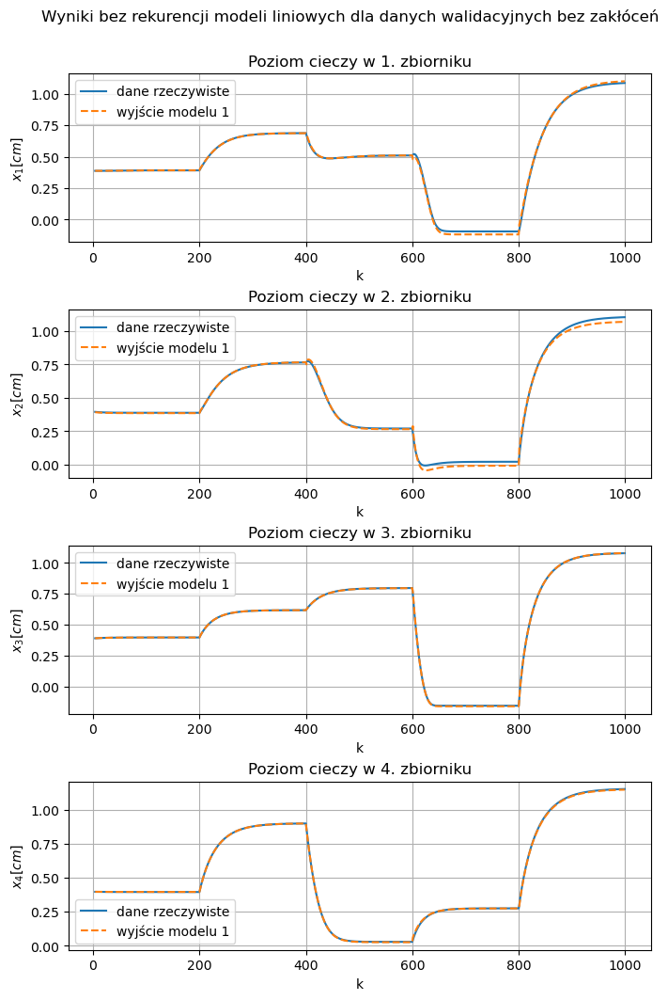

In [108]:
y_pred_dict = {"x1": x1_pred_val, "x2": x2_pred_val, "x3": x3_pred_val, "x4": x4_pred_val}
plot_model_result_all_tanks(df_val, dataset_name, "walidacyjnych", pred_mode, y_pred_dict)

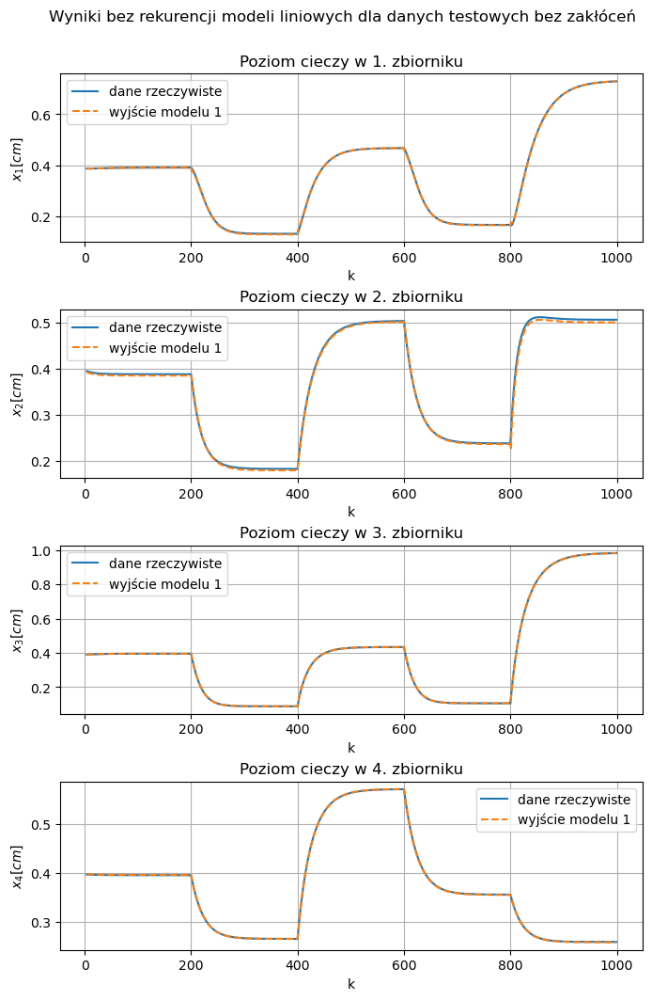

In [109]:
y_pred_dict = {"x1": x1_pred_test, "x2": x2_pred_test, "x3": x3_pred_test, "x4": x4_pred_test}
plot_model_result_all_tanks(df_test, dataset_name, "testowych", pred_mode, y_pred_dict)

In [114]:
pred_mode = "z rekurencją"

In [118]:
# x1
logged_model = 'runs:/6d4684620fc544f6b6f1b1479b60c6c2/ELM'
# Load model as a PyFuncModel.
loaded_model = mlflow.pyfunc.load_model(logged_model)
loaded_model_unwrap = loaded_model.unwrap_python_model().model
x1_pred_train = loaded_model.predict(pd.DataFrame(df_train[loaded_model_unwrap.feature_names_in_]))
x1_pred_test = loaded_model.predict(pd.DataFrame(df_test[loaded_model_unwrap.feature_names_in_]))
x1_pred_val = loaded_model.predict(pd.DataFrame(df_val[loaded_model_unwrap.feature_names_in_]))

# x2
logged_model = 'runs:/7b58363458f34d7f86604b788d27582c/ELM'
# Load model as a PyFuncModel.
loaded_model = mlflow.pyfunc.load_model(logged_model)
loaded_model_unwrap = loaded_model.unwrap_python_model().model
x2_pred_train = loaded_model.predict(pd.DataFrame(df_train[loaded_model_unwrap.feature_names_in_]))
x2_pred_test = loaded_model.predict(pd.DataFrame(df_test[loaded_model_unwrap.feature_names_in_]))
x2_pred_val = loaded_model.predict(pd.DataFrame(df_val[loaded_model_unwrap.feature_names_in_]))

# x3
logged_model = 'runs:/02f8e67e11094272a3625e4afddd2859/ELM'
# Load model as a PyFuncModel.
loaded_model = mlflow.pyfunc.load_model(logged_model)
loaded_model_unwrap = loaded_model.unwrap_python_model().model
x3_pred_train = loaded_model.predict(pd.DataFrame(df_train[loaded_model_unwrap.feature_names_in_]))
x3_pred_test = loaded_model.predict(pd.DataFrame(df_test[loaded_model_unwrap.feature_names_in_]))
x3_pred_val = loaded_model.predict(pd.DataFrame(df_val[loaded_model_unwrap.feature_names_in_]))

# x4
logged_model = 'runs:/e7f1f243d39543b19e7f49499e06c83b/ELM'
# Load model as a PyFuncModel.
loaded_model = mlflow.pyfunc.load_model(logged_model)
loaded_model_unwrap = loaded_model.unwrap_python_model().model
x4_pred_train = loaded_model.predict(pd.DataFrame(df_train[loaded_model_unwrap.feature_names_in_]))
x4_pred_test = loaded_model.predict(pd.DataFrame(df_test[loaded_model_unwrap.feature_names_in_]))
x4_pred_val = loaded_model.predict(pd.DataFrame(df_val[loaded_model_unwrap.feature_names_in_]))

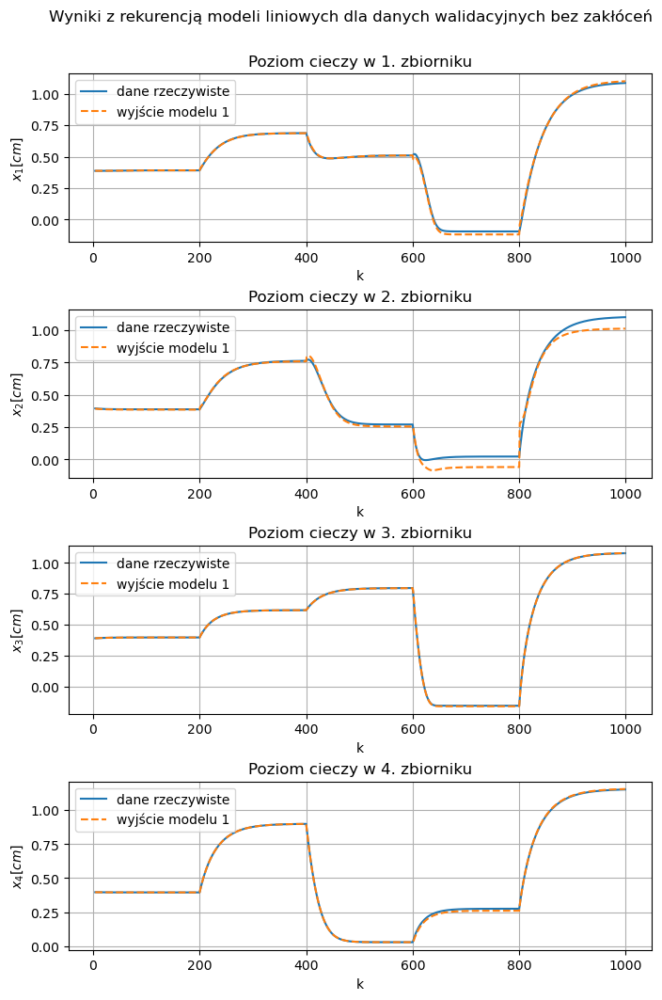

In [119]:
y_pred_dict = {"x1": x1_pred_val, "x2": x2_pred_val, "x3": x3_pred_val, "x4": x4_pred_val}
plot_model_result_all_tanks(df_val, dataset_name, "walidacyjnych", pred_mode, y_pred_dict)

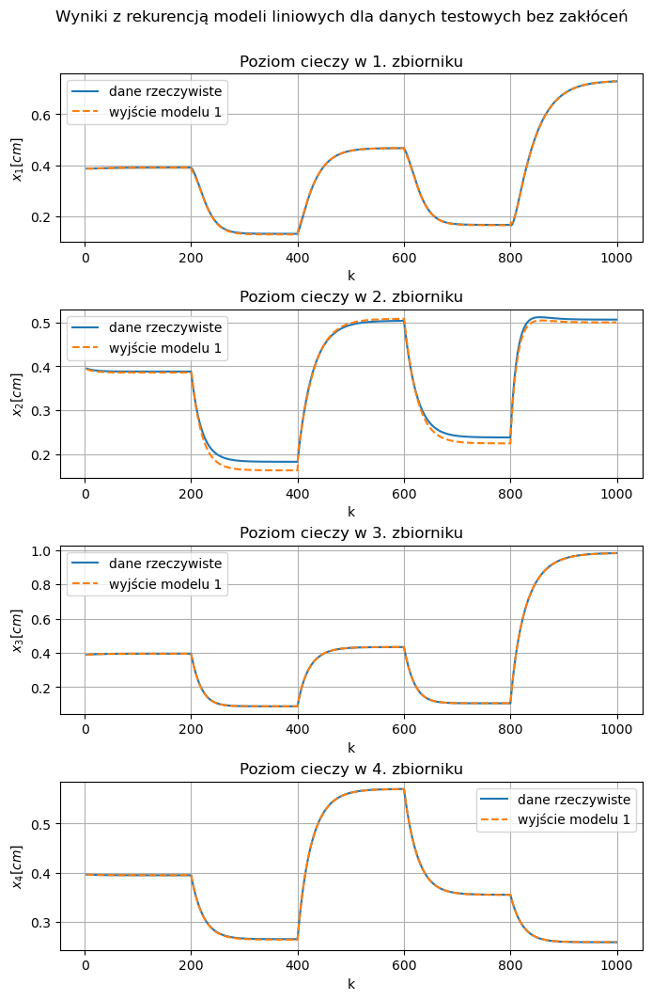

In [120]:
y_pred_dict = {"x1": x1_pred_test, "x2": x2_pred_test, "x3": x3_pred_test, "x4": x4_pred_test}
plot_model_result_all_tanks(df_test, dataset_name, "testowych", pred_mode, y_pred_dict)

In [279]:
def plot_model_error(df, y_name):
    plt.grid()
    e_list = [col for col in df.columns if (y_name in col) & ('e_x' in col)]
    colors = ['tab:orange', 'tab:green', 'tab:purple', 'tab:red', 'tab:cyan', 'tab:gray']
    color_i=0
    line_styles = ['--', '-.', (0, (5, 5)), (0, (3, 5, 1, 5)), ':']
    for i, e in enumerate(e_list):
        plt.plot(df[e], label=f'błąd modelu {i+1}', c=colors[i%len(colors)], linestyle=line_styles[i % len(line_styles)])
    plt.xlabel('k')
    plt.ylabel(f'$e_{{x{y_name[1]}}}$')
    plt.title(f"Błędy modeli dla {y_name[1]}. zbiornika")
    plt.legend()

In [280]:
def plot_model_error_without_h1(df, y_name):
    plt.grid()
    e_list = [col for col in df.columns if (y_name in col) & ('e_x' in col)]
    colors = ['tab:orange', 'tab:green', 'tab:purple', 'tab:red', 'tab:cyan', 'tab:gray']
    line_styles = ['--', '-.', (0, (5, 5)), (0, (3, 5, 1, 5)), ':']
    for i, e in enumerate(e_list):
        i += 1
        plt.plot(df[e], label=f'błąd modelu {i+1}', c=colors[i%len(colors)], linestyle=line_styles[i % len(line_styles)])
    plt.xlabel('k')
    plt.ylabel(f'$e_{{x{y_name[1]}}}$')
    plt.title(f"Błędy modeli dla {y_name[1]}. zbiornika")
    plt.legend()

In [281]:
def plot_model_error_all_tanks(df, dataset_name, data_name, pred_mode):
    num_plots = 4
    if pred_mode=='z rekurencją':
        num_plots=5
    fig=plt.figure(figsize=(8,11.5))
    plt.subplot(num_plots, 1, 1)
    plot_model_error(df, 'x1')
    plt.subplot(num_plots, 1, 2)
    plot_model_error(df, 'x2')
    plt.subplot(num_plots, 1, 3)
    plot_model_error(df, 'x3')
    if pred_mode=='z rekurencją':
        plt.subplot(num_plots, 1, 4)
        df_to_plot = df.drop(columns=['e_x3_statespace_1'])
        plot_model_error_without_h1(df_to_plot, 'x3')
    plt.subplot(num_plots, 1, num_plots)
    plot_model_error(df, 'x4')

    plt.subplots_adjust(hspace=0.4*num_plots/4)
    fig.subplots_adjust(top=0.92)
    fig.suptitle(f"Błędy modeli liniowych dla danych {data_name} {dataset_name} w trybie {pred_mode}")

    plt.savefig(f"../img/error_ol_{model_class}_{data_name}_{dataset_name}_v3_{pred_mode}.png", bbox_inches='tight')

    plt.show()

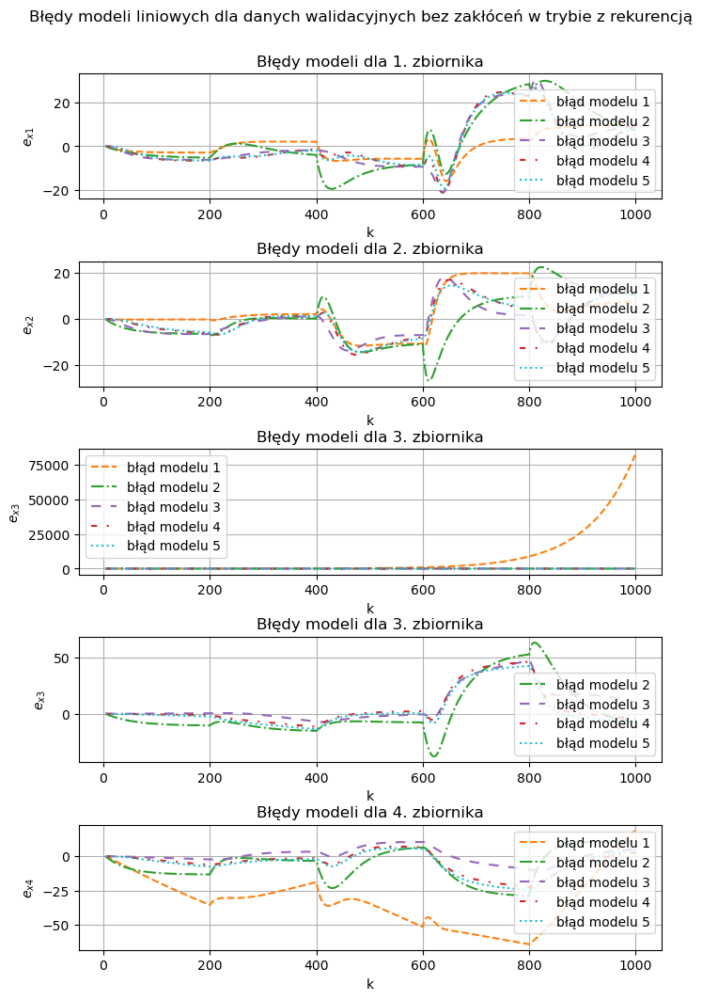

In [282]:
plot_model_error_all_tanks(df_val, dataset_name, "walidacyjnych", pred_mode)

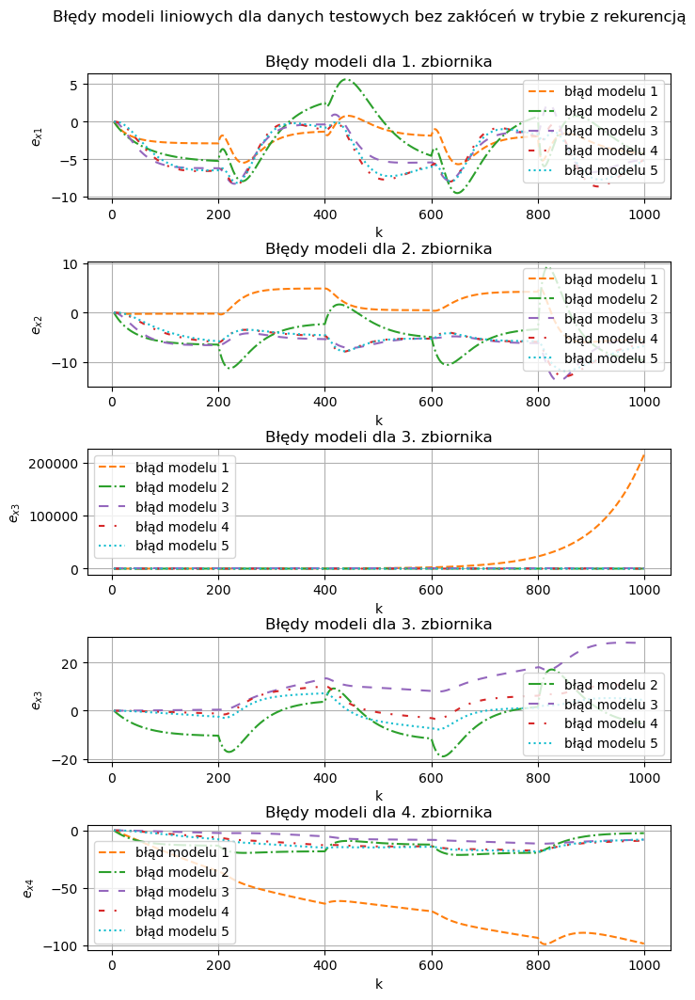

In [283]:
plot_model_error_all_tanks(df_test, dataset_name, "testowych", pred_mode)